<a href="https://colab.research.google.com/github/tnguy247/ml_project/blob/main/Advanced_Topic_Modeling.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Imports

Install required packages

In [ ]:
requirements = [
                ('tomotopy',), 
                ('contractions',),
                ('pyLDAvis',), 
                ('bayes_opt', 'bayesian-optimization'), 
                ('Pyro4',),
                ('wordcloud',)
                ]

for package,*install in requirements:
    
    try:
        __import__(package)
    except ImportError:
        !pip install {install and install[0] or package}


In [ ]:
import pandas as pd
import json
import gzip 
import os
import nltk
import spacy
from nltk import FreqDist
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import warnings
import tomotopy as tp
import gensim
import gensim.corpora as corpora
from gensim.models import CoherenceModel
import pyLDAvis
import pyLDAvis.gensim_models
warnings.filterwarnings("ignore", category=DeprecationWarning) 

# Load Data

Download pre-generated csv files

In [ ]:
if not os.path.exists('reviews_electronics.csv'):
    !gdown --id 1U_8tEcvfSUgVtr9d_68Pw2J8H6EBPgiT

Generate csv files from scratch

In [ ]:
if not os.path.exists('reviews_electronics.csv'):
    !curl -O http://deepyeti.ucsd.edu/jianmo/amazon/categoryFilesSmall/Electronics_5.json.gz
    def parse(path):
        g = gzip.open(path, 'rb')
        for l in g:
            yield json.loads(l)
    def getDF(path):
        i = 0
        df = {}
        for d in parse(path):
            df[i] = d
            i += 1
        return pd.DataFrame.from_dict(df, orient='index')

    rw_df = getDF('Electronics_5.json.gz')[['overall', 'asin', 'reviewText']]
    # Only save top 100 reviewed products
    most_reviewed_products = rw_df['asin'].value_counts().iloc[:100]
    rw_df[rw_df['asin'].isin(most_reviewed_products.index)].to_csv('reviews_electronics.csv', index=False)

Load in data

In [ ]:
rw_df = pd.read_csv('reviews_electronics.csv')
rw_df.head()

,overall,asin,reviewText
0,5.0,B00004ZCJI,Such an incredible quality!
1,5.0,B00004ZCJI,BUY IT TOGETHER WITH THE CANON 50 MM
2,4.0,B00004ZCJI,Quality product
3,5.0,B00004ZCJI,Great filter and great price.
4,1.0,B00004ZCJI,I order 3 filter I received 3 box one was empty.


Get the top 10 worst average rating products

In [ ]:
worst_10_reviewed = rw_df.groupby('asin')['overall'].mean().sort_values().iloc[:10]
worst_10_reviewed

asin
B01DJL4DY0    3.726565
B008GVOVK0    3.728013
B00E98O7GC    3.828318
B00IF70T4M    3.836508
B00B46XUQU    3.850385
B004OVECU0    4.005747
B000ZH98LU    4.032491
B00L0YLRUW    4.064782
B00STP86CW    4.081317
B00LP6CFEC    4.085190
Name: overall, dtype: float64

Get the top 5 most review products

In [ ]:
most_reviewed_products = rw_df[rw_df['asin'].isin(worst_10_reviewed.index)]['asin'].value_counts().iloc[:5]
most_reviewed_products

B00L0YLRUW    5696
B004OVECU0    3132
B01DJL4DY0    3083
B008GVOVK0    3070
B000ZH98LU    3047
Name: asin, dtype: int64

Reduce dataframe to only include those 5 products

In [ ]:
rw_df = rw_df[rw_df['asin'].isin(most_reviewed_products.index)]
rw_df.head()

,overall,asin,reviewText
50561,5.0,B000ZH98LU,"Obviously these are not $100 speakers, and the..."
50562,1.0,B000ZH98LU,I'm giving this one star because it at least w...
50563,5.0,B000ZH98LU,These basic speakers are great and simple to u...
50564,4.0,B000ZH98LU,These are nice little speakers! They're USB po...
50565,5.0,B000ZH98LU,Great compact speakers. If you're looking for ...


In [ ]:
rw_df.groupby('asin')['overall'].mean()

asin
B000ZH98LU    4.032491
B004OVECU0    4.005747
B008GVOVK0    3.728013
B00L0YLRUW    4.064782
B01DJL4DY0    3.726565
Name: overall, dtype: float64

# Product Selection

In [ ]:
#@title Select product number to view { run: "auto" }
product_number = 3 #@param {type:"slider", min:1, max:5, step:1}
rating = 3 #@param {type:"slider", min:1, max:5, step:1}
df = rw_df[
           (rw_df['asin'] == most_reviewed_products.index[product_number-1]) 
                & (rw_df['overall'] <= rating)
].copy()
df['reviewText'] = df['reviewText'].str.encode(encoding='utf-8')
df['reviewText'] = df['reviewText'].str.decode(encoding='utf-8')
df['reviewText'] = df['reviewText'].astype(str)
df

,overall,asin,reviewText
367466,1.0,B01DJL4DY0,This product was advertised as an automatic sw...
367468,1.0,B01DJL4DY0,didn't work
367469,1.0,B01DJL4DY0,Bought on prime day. It's been sitting there ...
367471,1.0,B01DJL4DY0,Not a good multi input switch. Too much delay
367472,1.0,B01DJL4DY0,Had serious issues from the very beginning. It...
...,...,...,...
370518,1.0,B01DJL4DY0,If hooked to TV it cuts it off. Thought it wou...
370520,1.0,B01DJL4DY0,We bought this to replace a cheap GE device wh...
370522,3.0,B01DJL4DY0,This is a decent switch - but unlike others wh...
370524,1.0,B01DJL4DY0,This HDMI switch does not work automatically a...


# Exploratory Analysis

Create a function to find and plot the most 20 frequent words in the review.

In [ ]:
def freq_words(x, terms = 20):
  all_words = ' '.join([text for text in x])
  all_words = all_words.split()

  fdist = FreqDist(all_words)
  words_df = pd.DataFrame({'word':list(fdist.keys()), 'count':list(fdist.values())})

  # selecting top 20 most frequent words
  d = words_df.nlargest(columns="count", n = terms) 
  plt.figure(figsize=(10,5))
  ax = sns.barplot(data=d, x= "word", y = "count")
  ax.set(ylabel = 'Count')
  plt.show()

Plot the hist graph about the most frequent words in the review.

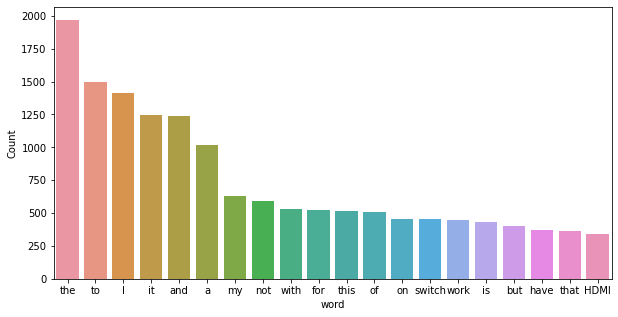

In [ ]:
freq_words(df['reviewText'])

# Classic Topic Modeling (No Root Extraction)

## Text Preprocessing

We can see that there are some common words such as "the", "to", "for", "this", "in", "a", "is", ... These words are not really important and relevant so we will remove them. First, we will try to remove stop words such as "a", "the", "is", "are" and short words (<3 letters) from the review. We also removed a few custom words that are not very useful to analyzing reviews.

In [ ]:
import nltk
import re
nltk.download('stopwords')
from nltk.corpus import stopwords
import contractions
stop_words = set(stopwords.words('english'))
stop_words.remove('few')
stop_words.update({'i', 'use', 'would', 'get', 'buy', 'try', 'come', 'send', 'give'})

# function to remove stopwords
def remove_stopwords(rev):
    rev_new = " ".join([i for i in rev if i not in stop_words])
    return rev_new

# remove short words (length < 3)
g = df['reviewText'].apply(lambda x: ' '.join([w for w in x.split() if len(w)>2]))


# using contractions.fix to expand the shortened words
reviews = [contractions.fix(r) for r in g]

# make entire text lowercase
reviews = [r.lower() for r in reviews]

# remove stopwords and custom stopwords from the text
reviews = [remove_stopwords(r.split()) for r in reviews]

# Remove punctuation
reviews = [re.sub('[^\w\s]', '', r) for r in reviews]

# remove empty rows
reviews = [ r.strip() for r in reviews if len(r.strip()) >= 1]

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


Construct bigrams

In [ ]:
from gensim.utils import simple_preprocess
from gensim.models import Phrases
from gensim.models.phrases import Phraser

word_list = [txt.split() for txt in reviews]
bigram = Phrases(word_list, min_count=2, threshold=1) 
bigram_model = Phraser(bigram)
word_list = [bigram_model[w_vec] for w_vec in word_list]

Plot the most frequent words in the review again to see if there are more significant words have come out.

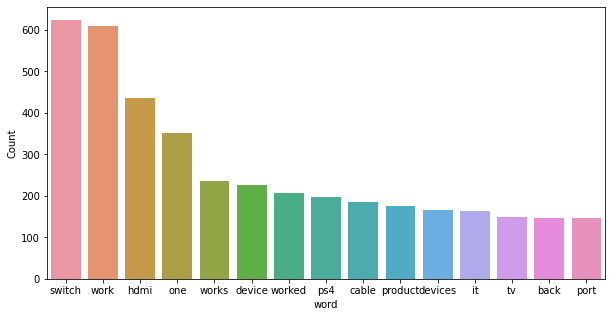

In [ ]:
freq_words(reviews, 15)

## Finding optimal n-topics with HDP

Train HDP model

In [ ]:
%%time
import tomotopy as tp
term_weight = tp.TermWeight.IDF
hdp = tp.HDPModel(tw=term_weight, initial_k=2, seed=99999)

# Add docs to train
for vec in word_list: 
    hdp.add_doc(vec)

# Initiate sampling burn-in  (i.e. discard N first iterations)
hdp.burn_in = 100
hdp.train(0)
print('Num docs:', len(hdp.docs), ', Vocab size:', hdp.num_vocabs,
      ', Num words:', hdp.num_words)

# Train model
for i in range(0, 1000, 100):
    hdp.train(100) # 100 iterations at a time
    print('Iteration: {}\tLog-likelihood: {}\tNum. of topics: {}'.format(i, hdp.ll_per_word, hdp.live_k))


Num docs: 1056 , Vocab size: 3685 , Num words: 19027
Iteration: 0	Log-likelihood: -6.414585215229983	Num. of topics: 232
Iteration: 100	Log-likelihood: -6.022721180302255	Num. of topics: 386
Iteration: 200	Log-likelihood: -5.9511184932667165	Num. of topics: 409
Iteration: 300	Log-likelihood: -5.952704805411783	Num. of topics: 409
Iteration: 400	Log-likelihood: -5.863348891698576	Num. of topics: 435
Iteration: 500	Log-likelihood: -5.830210042484005	Num. of topics: 429
Iteration: 600	Log-likelihood: -5.855086113637444	Num. of topics: 429
Iteration: 700	Log-likelihood: -5.814340161790268	Num. of topics: 437
Iteration: 800	Log-likelihood: -5.824651715236852	Num. of topics: 440
Iteration: 900	Log-likelihood: -5.816896225068865	Num. of topics: 440
CPU times: user 1min 8s, sys: 355 ms, total: 1min 8s
Wall time: 40.9 s


In [ ]:
sorted_topics = [k for k, v in sorted(enumerate(hdp.get_count_by_topics()), key=lambda x:x[1], reverse=True)]

topics=dict()

# For topics found, extract only those that are still assigned
for k in sorted_topics:
    if not hdp.is_live_topic(k): continue # remove un-assigned topics at the end (i.e. not alive)
    topic_wp =[]
    for word, prob in hdp.get_topic_words(k, top_n=10):
        topic_wp.append((word, prob))

    topics[k] = topic_wp # store topic word/frequency array

vocab = corpora.Dictionary(word_list)
corpus = [vocab.doc2bow(words) for words in word_list]

 # Build topic list from dictionary
topic_list=[]
for k, tups in topics.items():
    topic_tokens=[]
    for w, p in tups:
        topic_tokens.append(w)
        
    topic_list.append(topic_tokens)

Build a word cloud for each topic

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:25: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


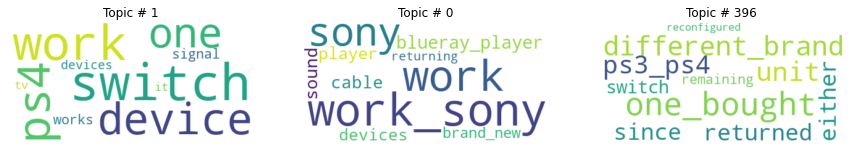

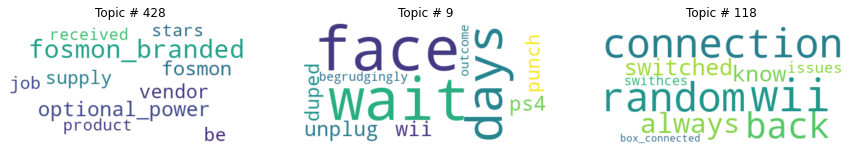

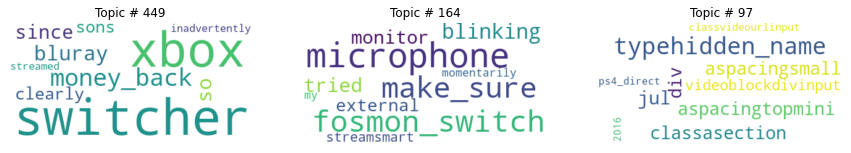

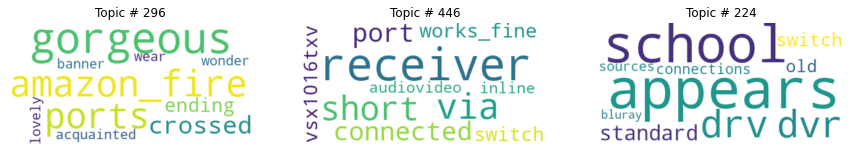

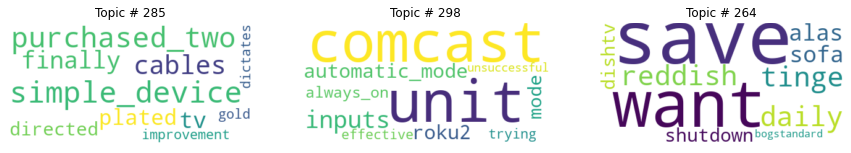

...

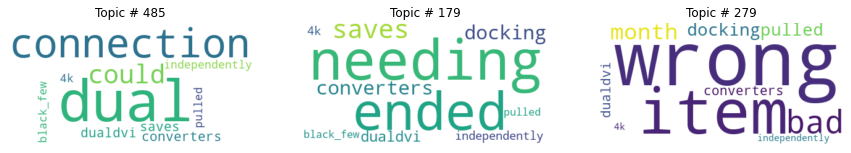

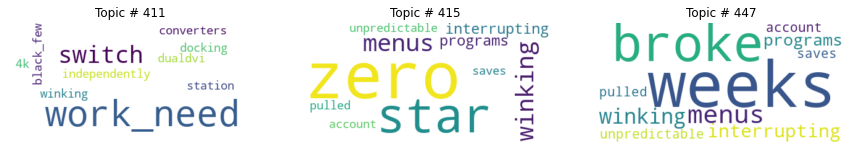

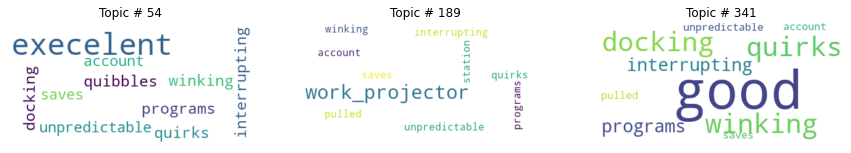

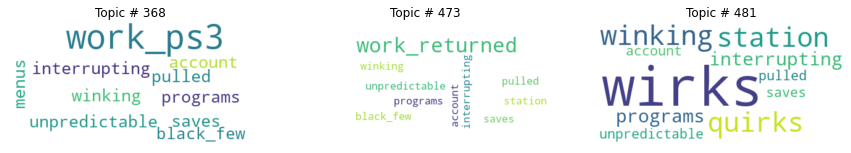

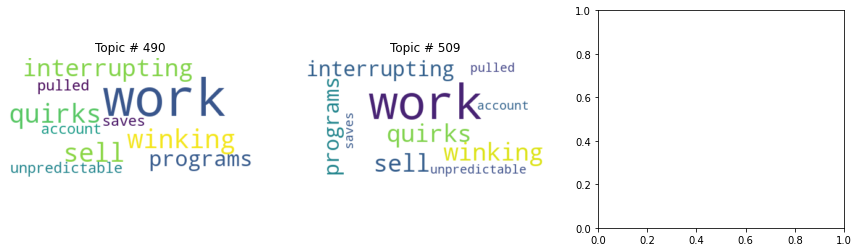

In [ ]:
from wordcloud import WordCloud


model = hdp
wcloud = WordCloud(background_color="white")
fig, ax = plt.subplots(1, 3, figsize=(15,4))

cnt=0
for k, arr in topics.items():
    
    wcloud = WordCloud(background_color='white')
    
    topic_freqs = dict(model.get_topic_words(k))
    
    img = wcloud.generate_from_frequencies(topic_freqs)
    
    ax[cnt].imshow(img, interpolation='bilinear')
    ax[cnt].axis('off')
    
    ax[cnt].title.set_text("Topic # " + str(k))
    cnt+=1
    
    if cnt==3:
        cnt=0
        fig, ax = plt.subplots(1, 3, figsize=(15,4))
    

In [ ]:
# Optimal number of topics
hdp.live_k

452

Input optimal n-topics into LDA

In [ ]:
%%time
dictionary = corpora.Dictionary(word_list)
doc_term_matrix = [dictionary.doc2bow(rev) for rev in word_list]
# Creating the object for LDA model using gensim library
LDA = gensim.models.ldamodel.LdaModel

# Build LDA model with passing the most optimal number of topic that we get above
lda_model = LDA(corpus=doc_term_matrix, id2word=dictionary, num_topics=hdp.live_k, random_state=100,
                chunksize=1000, passes=50)
#visualize the topic
pyLDAvis.enable_notebook()
vis = pyLDAvis.gensim_models.prepare(lda_model, doc_term_matrix, dictionary)
vis.topic_coordinates['x'] = np.real(vis.topic_coordinates['x'])
vis.topic_coordinates['y'] = np.real(vis.topic_coordinates['y'])
vis

/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1023: RuntimeWarning: divide by zero encountered in log
  diff = np.log(self.expElogbeta)
/usr/local/lib/python3.7/dist-packages/pyLDAvis/_prepare.py:247: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
  by='saliency', ascending=False).head(R).drop('saliency', 1)


PreparedData(topic_coordinates=              x         y  topics  cluster      Freq
topic                                               
76     0.159239  0.024026       1        1  1.126835
133    0.192370  0.064090       2        1  1.055853
310    0.230862 -0.230367       3        1  0.854729
47     0.190514  0.056125       4        1  0.772588
295    0.053081 -0.072002       5        1  0.723140
...         ...       ...     ...      ...       ...
34    -0.177680 -0.006986     448        1  0.010809
203   -0.177680 -0.006986     449        1  0.010809
397   -0.177680 -0.006986     450        1  0.010809
247   -0.177680 -0.006986     451        1  0.010809
167   -0.177680 -0.006986     452        1  0.010809

[452 rows x 5 columns], topic_info=                Term        Freq       Total  Category  logprob  loglift
13              work  263.000000  263.000000   Default   30.000  30.0000
36            switch  267.000000  267.000000   Default   29.000  29.0000
233              one  169.000000  169.000000   Default   28.000  28.0000
271           device  176.000000  176.000000   Default   27.000  27.0000
170          devices  113.000000  113.000000   Default   26.000  26.0000
..               ...         ...         ...       ...      ...      ...
25        plugged_in    0.000558   17.235220  Topic452   -8.212  -1.2054
26             prime    0.000558    7.271675  Topic452   -8.212  -0.3424
27            signal    0.000558   97.101459  Topic452   -8.212  -2.9342
28           sitting    0.000558    1.305217  Topic452   -8.212   1.3752
29   stopped_working    0.000558   24.506744  Topic452   -8.212  -1.5574

[21943 rows x 6 columns], token_table=      Topic      Freq      Term
term                           
2993    195  0.603045         1
713     127  0.911176        10
2543    197  0.584706      1080
849     310  0.868043     1080p
2385    224  0.481307    1080pa
...     ...       ...       ...
1887     71  0.484629       yes
578     262  0.677183       yet
1768    192  0.641016       you
3067    157  0.916902  youverse
810     268  0.783154      zero

[3243 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[77, 134, 311, 48, 296, 113, 357, 122, 433, 21, 443, 373, 409, 32, 130, 176, 318, 246, 103, 382, 415, 258, 68, 240, 369, 262, 397, 249, 71, 223, 184, 158, 63, 206, 388, 286, 216, 92, 281, 428, 279, 219, 446, 408, 389, 269, 189, 396, 34, 312, 320, 297, 347, 74, 73, 138, 218, 414, 170, 24, 391, 201, 169, 5, 257, 207, 7, 181, 344, 23, 229, 150, 214, 116, 37, 205, 49, 12, 175, 160, 431, 193, 114, 440, 125, 325, 422, 210, 302, 447, 17, 244, 315, 78, 94, 79, 39, 112, 220, 42, 300, 51, 445, 353, 82, 290, 242, 309, 272, 452, 404, 299, 259, 226, 58, 47, 268, 173, 339, 343, 331, 451, 60, 230, 98, 442, 256, 329, 194, 430, 151, 385, 14, 144, 8, 298, 241, 366, 105, 171, 381, 285, 213, 342, 56, 46, 140, 118, 438, 93, 282, 365, 208, 142, 145, 72, 419, 305, 87, 209, 334, 270, 437, 362, 405, 400, 186, 1, 235, 66, 367, 119, 128, 247, 45, 2, 18, 19, 182, 265, 233, 323, 418, 228, 348, 156, 29, 273, 53, 383, 335, 292, 157, 346, 9, 164, 412, 372, 232, 379, 185, 328, 102, 424, 15, 99, 227, 255, 191, 65, 326, 313, 4, 177, 217, 426, 20, 407, 139, 238, 243, 332, 427, 149, 432, 97, 183, 195, 88, 196, 280, 188, 294, 288, 147, 155, 109, 394, 153, 359, 38, 271, 95, 141, 316, 291, 136, 110, 36, 245, 444, 199, 200, 364, 308, 135, 295, 401, 355, 126, 263, 239, 399, 340, 376, 132, 61, 121, 161, 417, 70, 212, 133, 356, 64, 327, 148, 197, 83, 85, 284, 274, 211, 22, 416, 44, 55, 50, 252, 435, 3, 187, 307, 202, 275, 423, 178, 143, 192, 261, 420, 91, 314, 75, 377, 374, 267, 104, 26, 62, 198, 338, 264, 436, 439, 449, 351, 179, 384, 350, 159, 11, 152, 84, 251, 441, 76, 131, 392, 89, 345, 260, 174, 10, 341, 52, 375, 429, 322, 215, 360, 80, 203, 237, 33, 31, 450, 425, 124, 129, 330, 234, 250, 16, 231, 403, 25, 163, 354, 283, 166, 368, 371, 358, 59, 224, 363, 90, 413, 421, 276, 225, 172, 434, 117, 378, 254, 6, 69, 380, 11

## Finding optimal n-topics using Bayesian Optimization with LDA

In [ ]:
def optimize_LDA(num_topics): 
    dictionary = corpora.Dictionary(word_list)
    doc_term_matrix = [dictionary.doc2bow(rev) for rev in word_list]
    # Creating the object for LDA model using gensim library
    LDA = gensim.models.ldamodel.LdaModel

    # Build LDA model with passing the most optimal number of topic that we get above
    lda_model = LDA(corpus=doc_term_matrix, id2word=dictionary, num_topics=int(num_topics), random_state=100,
                    chunksize=100, passes=10, alpha=0.01, eta='auto')
    cm = CoherenceModel(model=lda_model, corpus=doc_term_matrix, dictionary=dictionary, texts=word_list, 
                        coherence='c_npmi')
        
    score = cm.get_coherence()
    return score

In [ ]:
%%time 
from bayes_opt import BayesianOptimization

# Bounded region of parameter space
pbounds = {'num_topics': [7,50]}#, 'alpha': (0.001, 0.1), 'eta': (0.1, 0.1)}

optimizer = BayesianOptimization(
    f=optimize_LDA,
    pbounds=pbounds,
    random_state=1,
)

optimizer.maximize(
    init_points=5,
    n_iter=25,
)

|   iter    |  target   | num_to... |
-------------------------------------
|  1        | -0.2983   |  24.93    |
|  2        | -0.342    |  37.97    |
|  3        | -0.1448   |  7.005    |
|  4        | -0.2773   |  20.0     |
|  5        | -0.2544   |  13.31    |
|  6        | -0.3739   |  50.0     |
|  7        | -0.1811   |  8.154    |
|  8        | -0.3242   |  31.11    |
|  9        | -0.1448   |  7.0      |
|  10       | -0.1448   |  7.0      |
|  11       | -0.1448   |  7.0      |
|  12       | -0.1448   |  7.0      |
|  13       | -0.1448   |  7.0      |
|  14       | -0.1448   |  7.0      |
|  15       | -0.1448   |  7.001    |
|  16       | -0.1448   |  7.001    |
|  17       | -0.1448   |  7.001    |
|  18       | -0.1448   |  7.001    |
|  19       | -0.1448   |  7.001    |
|  20       | -0.1448   |  7.001    |
|  21       | -0.1448   |  7.001    |
|  22       | -0.1448   |  7.001    |
|  23       | -0.1448   |  7.001    |
|  24       | -0.1448   |  7.001    |
|  25       

In [ ]:
%%time
import gensim
from gensim import corpora
dictionary = corpora.Dictionary(word_list)
doc_term_matrix = [dictionary.doc2bow(rev) for rev in word_list]
# Creating the object for LDA model using gensim library
LDA = gensim.models.ldamodel.LdaModel

# Build LDA model with passing the most optimal number of topic that we get above
lda_model = LDA(corpus=doc_term_matrix, id2word=dictionary, num_topics=optimizer.max['params']['num_topics'], random_state=100,
                chunksize=1000, passes=50, alpha=0.01, eta='auto')
import pyLDAvis
import pyLDAvis.gensim_models
#visualize the topic
pyLDAvis.enable_notebook()
vis = pyLDAvis.gensim_models.prepare(lda_model, doc_term_matrix, dictionary)
display(vis)

/usr/local/lib/python3.7/dist-packages/pyLDAvis/_prepare.py:247: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
  by='saliency', ascending=False).head(R).drop('saliency', 1)


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
6     -0.022443 -0.051633       1        1  21.324587
0     -0.016607 -0.046462       2        1  17.661310
3      0.004560 -0.004163       3        1  14.488246
2      0.032829 -0.101526       4        1  13.848943
5     -0.226379  0.073517       5        1  13.383333
1      0.124605  0.216821       6        1  11.964418
4      0.103435 -0.086554       7        1   7.329163, topic_info=          Term        Freq       Total Category  logprob  loglift
36      switch  297.000000  297.000000  Default  30.0000  30.0000
149     inputs   61.000000   61.000000  Default  29.0000  29.0000
40   cable_box   99.000000   99.000000  Default  28.0000  28.0000
496       back   56.000000   56.000000  Default  27.0000  27.0000
856   computer   27.000000   27.000000  Default  26.0000  26.0000
..         ...         ...         ...      ...      ...      ...
669   watching    5.765456   12.313013   Topic7  -5.4884   1.8545
223        ps4    7.001192   60.105082   Topic7  -5.2942   0.4633
32        good    6.463584   40.014999   Topic7  -5.3741   0.7902
311      using    6.518422   51.897394   Topic7  -5.3657   0.5387
33       input    6.500013   50.560555   Topic7  -5.3685   0.5619

[489 rows x 6 columns], token_table=      Topic      Freq      Term
term                           
1097      6  0.911079        12
508       1  0.973879  2nd_hdmi
2146      6  0.910646  2nd_port
3173      6  0.930604  3rd_port
2579      2  0.986786        55
...     ...       ...       ...
1317      5  0.921262  works_ok
1074      1  0.096652     worth
1074      3  0.096652     worth
1074      4  0.096652     worth
1074      6  0.676565     worth

[1010 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[7, 1, 4, 3, 6, 2, 5])

CPU times: user 16.3 s, sys: 22 ms, total: 16.3 s
Wall time: 17.2 s


In [ ]:
#@title Print out topics with top 5 documents for each topic{ display-mode: "form" }
def format_topics_sentences(ldamodel, corpus, texts):
    # Init output
    sent_topics_df = pd.DataFrame()

    # Get main topic in each document
    for i, row in enumerate(ldamodel[corpus]):
        row = sorted(row, key=lambda x: (x[1]), reverse=True)
        # Get the Dominant topic, Perc Contribution and Keywords for each document
        for j, (topic_num, prop_topic) in enumerate(row):
            if j == 0:  # => dominant topic
                wp = ldamodel.show_topic(topic_num)
                topic_keywords = ", ".join([word for word, prop in wp])
                sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
            else:
                break
    sent_topics_df.columns = ['Dominant_Topic', 'Perc_Contribution', 'Topic_Keywords']

    # Add original text to the end of the output
    contents = pd.Series(texts)
    df_topic_sents_keywords = pd.concat([sent_topics_df, contents], axis=1)
    
    # Format
    df_dominant_topic = df_topic_sents_keywords.reset_index()
    df_dominant_topic.columns = ['Document_No', 'Dominant_Topic', 'Topic_Perc_Contrib', 'Keywords', 'Text']


    # Group top 5 sentences under each topic
    sent_topics_sorteddf_mallet = pd.DataFrame()

    sent_topics_outdf_grpd = df_topic_sents_keywords.groupby('Dominant_Topic')

    for i, grp in sent_topics_outdf_grpd:
        sent_topics_sorteddf_mallet = pd.concat([sent_topics_sorteddf_mallet, 
                                                grp.sort_values(['Perc_Contribution'], ascending=[0]).head(5)], 
                                                axis=0)

    # Reset Index    
    sent_topics_sorteddf_mallet.reset_index(drop=True, inplace=True)

    # Format
    sent_topics_sorteddf_mallet.columns = ['Topic_Num', "Topic_Perc_Contrib", "Keywords", "Text"]

    # Show top documents from each topic
    return pd.DataFrame(list(sent_topics_sorteddf_mallet.groupby('Topic_Num').apply(lambda x: {
        'topic': int(x['Topic_Num'].iloc[0]), 
        'keywords': x['Keywords'].iloc[0],
        'Document 1': (x['Text'].iloc[0]), 
        'Document 2': (x['Text'].iloc[1]), 
        'Document 3': (x['Text'].iloc[2]), 
        'Document 4': (x['Text'].iloc[3]), 
        'Document 5': (x['Text'].iloc[4]), 
        })))

format_topics_sentences(ldamodel=lda_model, corpus=doc_term_matrix, texts=reviews)


,topic,keywords,Document 1,Document 2,Document 3,Document 4,Document 5
0,0,"work, hdmi, tv, fine, device, picture, splitte...",theory great device allows augment number avai...,thought hdmi switch apparently so upon playing...,good works intended general automatically sele...,find place hide behind tv exchange entire wall...,neat idea fails work happens device switch aut...
1,1,"inputs, switch, device, unit, power, devises, ...",spent last hour trying make unit switch automa...,connected hdmi switch one two hdmi ports avail...,received today pretty simple plug play althoug...,device advertised able automatically switch in...,product worked wonderfully advertised month au...
2,2,"switch, work, one, devices, this, tv, ps4, sev...",trying att youverse wireless receiver playstat...,think thing defective work ps4 another hdmi de...,thing billed intelligent switch one got low iq...,worth money claims auto switching far concerne...,great product really worked advertised ordered...
3,3,"cable_box, work, one, tv, automatically, produ...",fairly good tech stuff simple device sure hard...,bought older flat one hdmi input tired getting...,one constantsignal device roku one onandoff de...,computer monitor computer tv used split hdmi l...,compatible tivo cable box bought two returning...
4,4,"switch, device, cable_box, back, wii, one, con...",first say following devices trying connect por...,div idvideoblockr73b8m5vlckjb classasection as...,received item timely fashion provided amazon p...,price right video quality good switch cable bo...,bought switch could plug game consoles tv howe...
5,5,"switch, player, device, one, blue_ray, also, i...",recently reached point needed hdmi inputs had ...,switch work applicationi ran hdmi ports receiv...,work right me fire alone worked switched back ...,ordered could working inputs output cause eith...,decent switch unlike others reviewed item swit...
6,6,"device, one, ports, switch, like, work, return...",bought replace cheap device whose manual butto...,bought plug dreamcast vga converted hdmi well ...,even though reviews spoke audio problems order...,really disappointed could switch working tried...,thing work two sources hooked up popped back f...


Error: Runtime no longer has a reference to this dataframe, please re-run this cell and try again.
Error: Runtime no longer has a reference to this dataframe, please re-run this cell and try again.


# Topic Modeling with Root Extraction

## Text Preprocessing

Extract the roots from sentences and build off it's dependencies to shortened the text

In [ ]:
import re
nlp = spacy.load('en_core_web_sm')
custom_stopwords = ['think', 'make', 'thank', 'find', 'happened', 'be', 'do', 'star']
def extract_verb_phrase(x):
    extents = {}
    data = []
    valid_deps = ['ROOT', 'nummod', 'appos', 'compound', 'npadvmod', 'conj', 'neg', 'nsubjpass', 'dobj', 'pobj', 'amod']
    expand_deps = ['ROOT', 'npadvmod', 'conj', 'nsubjpass', 'dobj', 'prep']
    combo_exceptions = [('prep', 'SCONJ')]
    
        
    def validate_token(token):
        if token.dep_ in valid_deps or (token.dep_, token.pos_) in combo_exceptions:
            return True
        return False
    def process_word(token, word_list):
        if token.dep_ == 'conj' and token.pos_ == 'VERB':
            add_sides(token,[token])
            return None, word_list
        elif token.dep_ in expand_deps: 
            return add_sides(token,word_list)
        return token,word_list
    def add_to_word_list(token, related_token, word_list, after=False):
        index = word_list.index(related_token)
        word_list.insert(index+after, token)
        return token, word_list
    def add_sides(token, word_list): 
        for l in token.lefts:
            if validate_token(l):
                tmp_token, tmp_word_list = add_to_word_list(l, token, word_list.copy())
                tmp_token, tmp_word_list = process_word(l, tmp_word_list)
                if tmp_token:
                    word_list = tmp_word_list 
        if len(list(token.rights)) == 0: 
            return token,word_list
        
        start_word_list = word_list.copy()
        rights = list(token.rights)
        for r in rights:
            if validate_token(r):
                tmp_token, tmp_word_list = add_to_word_list(r, token, word_list.copy(), after=True)
                tmp_token, tmp_word_list = process_word(r, tmp_word_list)
                if tmp_token:
                    data.append(tmp_word_list)
            
        if rights[0].text == ',':
            return token,start_word_list
        return None,word_list
    
    
    process_word(x.text, [x.text])
    for d in data:
        word_list = [w.text for w in d]
        indexes = [i for i,w in enumerate(word_list) if w == 'not']
        if len(indexes):
            negs = [d[i] for i in indexes]
            [d.remove(n) for n in negs]
            d.insert(0,negs[0])
    
    ret_value = [' '.join([w.lemma_ if w.lemma_ != '-PRON-' else w.text for w in d if w.lemma_ not in custom_stopwords]).lower().replace('not ', 'not_') for d in data if len(d) > 1]
    
    return ret_value if len(ret_value) else None

def extract_aux_phrase(x):
    lefts = [l for l in x.lefts if l.dep_ == 'nsubj' and l.pos_ != 'PRON']
    noun = lefts[0].lemma_ if len(lefts) else ''
    rights = [r.lemma_ for r in x.rights if r.dep_ in ['acomp']]
    adj = ' '.join(rights)
    neg = 'not' if any([c.dep_ == 'neg' for c in x.children]) else ''
    t = ' '.join([w for w in [neg, adj, noun] if len(w) > 0]).lower()
    return t.replace('not ', 'not_') if all([s not in t for s in custom_stopwords]) and len(t.split(' ')) > 1 else None

def extract_phrases(token):
    if token['pos'] == 'VERB':
        return extract_verb_phrase(token)
    elif token['pos'] == 'AUX':
        return extract_aux_phrase(token)    
def generate_sentences(sentence):
    data = []
    for token in sentence:
        data.append({
            'text': token, 
            'pos': token.pos_, 
            'dep': token.dep_, 
            'head_text': token.head.text, 
            'head_pos': token.head.pos_, 
            'ancestors': [child for child in token.ancestors],
            'children': [child for child in token.children],
            'lefts': [child for child in token.lefts],
            'rights': [child for child in token.rights],
            'subtree': [child for child in token.subtree],
            'lemma': token.lemma_,
            'sentence': str(sentence), 
        })
    return data

Apply regular text preprocessing along with root extraction and sentencization.

In [ ]:
import contractions
from spacy.pipeline import Sentencizer
# get only review text
reviews = df['reviewText'].copy(deep=True)
# convert contractions
reviews = reviews.apply(lambda x: contractions.fix(x))
# remove html
reviews = reviews.apply(lambda r: re.sub('<.+>', '', r))
# make a row for each sentence in review text
sentencizer = Sentencizer()
reviews = reviews.apply(lambda r: list(sentencizer(nlp(r)).sents)).explode()
# convert sentences to a row for each token
review_tokens = pd.DataFrame(list(reviews.apply(generate_sentences).explode()))
# convert to short phrases
phrases = review_tokens[review_tokens['dep'] == 'ROOT'].apply(extract_phrases, axis=1).explode()
# remove stopwords
phrases = phrases.apply(lambda x: remove_stopwords(x.split()).strip() if x else None)
# remove empty phrases
phrases = phrases[(~phrases.isna()) & (phrases.apply(lambda x: len(str(x).split()) > 1))]

phrases.head(20)

3              product advertise switch
23                    fosman technology
23                     receive response
158                        hate product
320                     not_last 1 year
426                     glitchy picture
442     multiple connection combination
477                not_waste time money
595                       see burn mark
635                 501bn 5 port switch
667                recivide second unit
667                    recivide problem
678                      return article
729                          save money
739                     waste 24 dollar
840                      skip old model
840                    skip new version
863                      function noisy
900                   receive high mark
1015                  fix 1-star rating
dtype: object

Construct bigrams

In [ ]:
from gensim.utils import simple_preprocess
from gensim.models import Phrases
from gensim.models.phrases import Phraser

word_list = [txt.split() for txt in phrases]
bigram = Phrases(word_list, min_count=2, threshold=1) 
bigram_model = Phraser(bigram)
word_list = [bigram_model[w_vec] for w_vec in word_list]

## Finding optimal n-topics with HDP

Train HDP model

In [ ]:
%%time
import tomotopy as tp
term_weight = tp.TermWeight.IDF
hdp = tp.HDPModel(tw=term_weight, initial_k=2, seed=99999)

# Add docs to train
for vec in word_list: 
    hdp.add_doc(vec)

# Initiate sampling burn-in  (i.e. discard N first iterations)
hdp.burn_in = 100
hdp.train(0)
print('Num docs:', len(hdp.docs), ', Vocab size:', hdp.num_vocabs,
      ', Num words:', hdp.num_words)

# Train model
for i in range(0, 1000, 100):
    hdp.train(100) # 100 iterations at a time
    print('Iteration: {}\tLog-likelihood: {}\tNum. of topics: {}'.format(i, hdp.ll_per_word, hdp.live_k))


Num docs: 762 , Vocab size: 657 , Num words: 1742
Iteration: 0	Log-likelihood: -3.76776935556815	Num. of topics: 81
Iteration: 100	Log-likelihood: -3.084671074838326	Num. of topics: 353
Iteration: 200	Log-likelihood: -3.0185684285751098	Num. of topics: 352
Iteration: 300	Log-likelihood: -3.052768793316184	Num. of topics: 335
Iteration: 400	Log-likelihood: -3.0017319296263985	Num. of topics: 361
Iteration: 500	Log-likelihood: -3.020870537007177	Num. of topics: 367
Iteration: 600	Log-likelihood: -2.9945345996957564	Num. of topics: 359
Iteration: 700	Log-likelihood: -3.0062378824144145	Num. of topics: 350
Iteration: 800	Log-likelihood: -2.9545848482742834	Num. of topics: 374
Iteration: 900	Log-likelihood: -2.9924037222839437	Num. of topics: 363
CPU times: user 5.41 s, sys: 258 ms, total: 5.67 s
Wall time: 3.9 s


In [ ]:
sorted_topics = [k for k, v in sorted(enumerate(hdp.get_count_by_topics()), key=lambda x:x[1], reverse=True)]

topics=dict()

# For topics found, extract only those that are still assigned
for k in sorted_topics:
    if not hdp.is_live_topic(k): continue # remove un-assigned topics at the end (i.e. not alive)
    topic_wp =[]
    for word, prob in hdp.get_topic_words(k, top_n=10):
        topic_wp.append((word, prob))

    topics[k] = topic_wp # store topic word/frequency array

vocab = corpora.Dictionary(word_list)
corpus = [vocab.doc2bow(words) for words in word_list]

 # Build topic list from dictionary
topic_list=[]
for k, tups in topics.items():
    topic_tokens=[]
    for w, p in tups:
        topic_tokens.append(w)
        
    topic_list.append(topic_tokens)

Build a word cloud for each topic

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:25: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


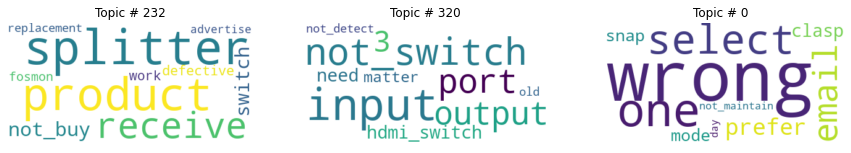

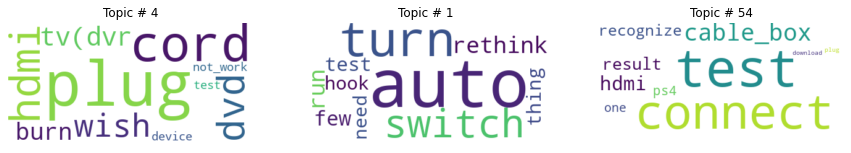

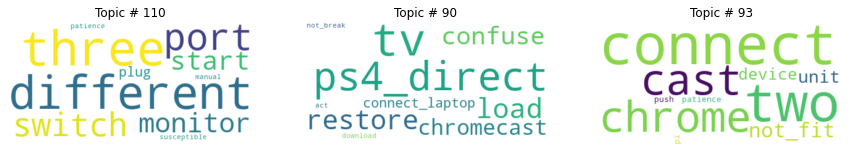

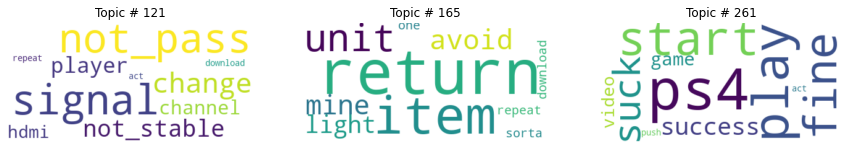

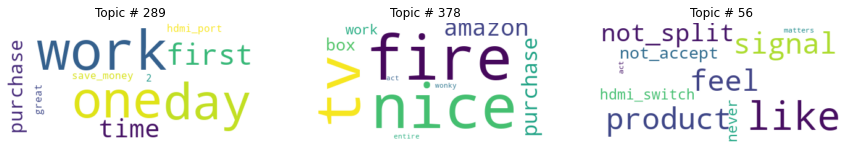

...

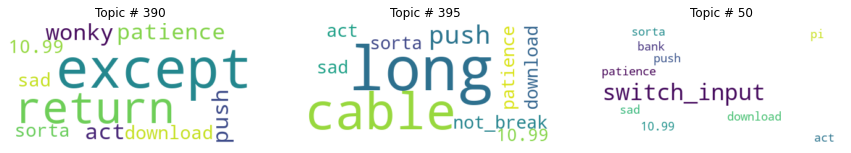

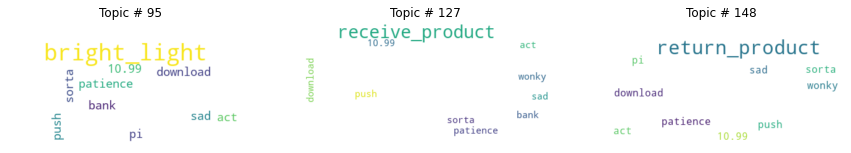

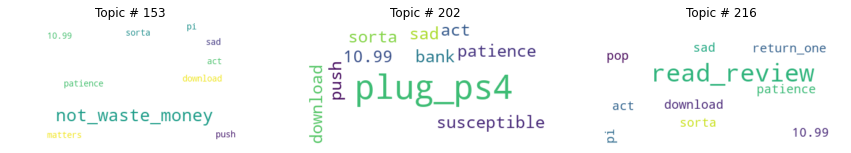

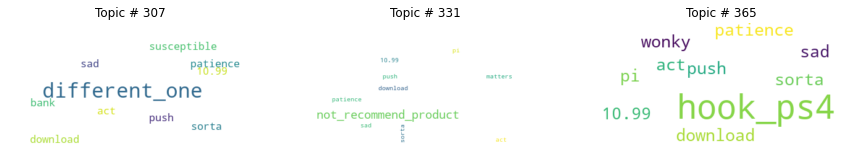

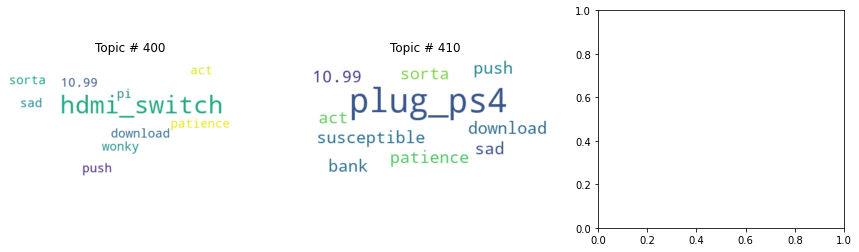

In [ ]:
from wordcloud import WordCloud


model = hdp
wcloud = WordCloud(background_color="white")
fig, ax = plt.subplots(1, 3, figsize=(15,4))

cnt=0
for k, arr in topics.items():
    
    wcloud = WordCloud(background_color='white')
    
    topic_freqs = dict(model.get_topic_words(k))
    
    img = wcloud.generate_from_frequencies(topic_freqs)
    
    ax[cnt].imshow(img, interpolation='bilinear')
    ax[cnt].axis('off')
    
    ax[cnt].title.set_text("Topic # " + str(k))
    cnt+=1
    
    if cnt==3:
        cnt=0
        fig, ax = plt.subplots(1, 3, figsize=(15,4))
    

In [ ]:
# Optimal number of topics
hdp.live_k

371

Input optimal n-topics into LDA

In [ ]:
%%time
dictionary = corpora.Dictionary(word_list)
doc_term_matrix = [dictionary.doc2bow(rev) for rev in word_list]
# Creating the object for LDA model using gensim library
LDA = gensim.models.ldamodel.LdaModel

# Build LDA model with passing the most optimal number of topic that we get above
lda_model = LDA(corpus=doc_term_matrix, id2word=dictionary, num_topics=hdp.live_k, random_state=100,
                chunksize=1000, passes=50)
#visualize the topic
pyLDAvis.enable_notebook()
vis = pyLDAvis.gensim_models.prepare(lda_model, doc_term_matrix, dictionary)
vis.topic_coordinates['x'] = np.real(vis.topic_coordinates['x'])
vis.topic_coordinates['y'] = np.real(vis.topic_coordinates['y'])
vis

/usr/local/lib/python3.7/dist-packages/gensim/models/ldamodel.py:1023: RuntimeWarning: divide by zero encountered in log
  diff = np.log(self.expElogbeta)
/usr/local/lib/python3.7/dist-packages/pyLDAvis/_prepare.py:247: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
  by='saliency', ascending=False).head(R).drop('saliency', 1)


CPU times: user 39.7 s, sys: 209 ms, total: 39.9 s
Wall time: 49.6 s


## Finding optimal n-topics using Bayesian Optimization with LDA

In [ ]:
def optimize_LDA(num_topics): 
    dictionary = corpora.Dictionary(word_list)
    doc_term_matrix = [dictionary.doc2bow(rev) for rev in word_list]
    # Creating the object for LDA model using gensim library
    LDA = gensim.models.ldamodel.LdaModel

    # Build LDA model with passing the most optimal number of topic that we get above
    lda_model = LDA(corpus=doc_term_matrix, id2word=dictionary, num_topics=int(num_topics), random_state=100,
                    chunksize=100, passes=10, alpha=0.01, eta='auto')
    cm = CoherenceModel(model=lda_model, corpus=doc_term_matrix, dictionary=dictionary, texts=word_list, 
                        coherence='c_npmi')
        
    score = cm.get_coherence()
    return score

In [ ]:
%%time 
from bayes_opt import BayesianOptimization

# Bounded region of parameter space
pbounds = {'num_topics': [7,50]}#, 'alpha': (0.001, 0.1), 'eta': (0.1, 0.1)}

optimizer = BayesianOptimization(
    f=optimize_LDA,
    pbounds=pbounds,
    random_state=1,
)

optimizer.maximize(
    init_points=5,
    n_iter=25,
)

|   iter    |  target   | num_to... |
-------------------------------------
|  1        | -0.4673   |  24.93    |
|  2        | -0.4714   |  37.97    |
|  3        | -0.5719   |  7.005    |
|  4        | -0.4789   |  20.0     |
|  5        | -0.5155   |  13.31    |
|  6        | -0.4953   |  50.0     |
|  7        | -0.4658   |  31.61    |
|  8        | -0.462    |  28.4     |
|  9        | -0.4847   |  42.99    |
|  10       | -0.4628   |  27.41    |
|  11       | -0.4684   |  29.28    |
|  12       | -0.4646   |  34.74    |
|  13       | -0.4681   |  22.54    |
|  14       | -0.4882   |  46.34    |
|  15       | -0.463    |  33.2     |
|  16       | -0.4746   |  40.18    |
|  17       | -0.4916   |  17.1     |
|  18       | -0.4689   |  36.13    |
|  19       | -0.4628   |  27.96    |
|  20       | -0.4619   |  26.19    |
|  21       | -0.4689   |  32.46    |
|  22       | -0.4637   |  23.62    |
|  23       | -0.463    |  33.92    |
|  24       | -0.4599   |  30.73    |
|  25       

In [ ]:
%%time
import gensim
from gensim import corpora
dictionary = corpora.Dictionary(word_list)
doc_term_matrix = [dictionary.doc2bow(rev) for rev in word_list]
# Creating the object for LDA model using gensim library
LDA = gensim.models.ldamodel.LdaModel

# Build LDA model with passing the most optimal number of topic that we get above
lda_model = LDA(corpus=doc_term_matrix, id2word=dictionary, num_topics=optimizer.max['params']['num_topics'], random_state=100,
                chunksize=1000, passes=50, alpha=0.01, eta='auto')
import pyLDAvis
import pyLDAvis.gensim_models
#visualize the topic
pyLDAvis.enable_notebook()
vis = pyLDAvis.gensim_models.prepare(lda_model, doc_term_matrix, dictionary)
display(vis)

/usr/local/lib/python3.7/dist-packages/pyLDAvis/_prepare.py:247: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
  by='saliency', ascending=False).head(R).drop('saliency', 1)


PreparedData(topic_coordinates=              x         y  topics  cluster      Freq
topic                                               
8      0.012291  0.157488       1        1  5.072632
4      0.183089 -0.039950       2        1  4.908696
3      0.220242 -0.100389       3        1  4.884706
17    -0.138417 -0.122876       4        1  4.492431
24    -0.020522 -0.151206       5        1  4.112318
10    -0.014697 -0.008390       6        1  4.111268
22     0.015288  0.028347       7        1  3.957236
2     -0.011170  0.086874       8        1  3.644257
11     0.014464  0.040507       9        1  3.572552
20     0.053740 -0.005629      10        1  3.468188
1     -0.063959  0.038562      11        1  3.449108
19     0.041755  0.005154      12        1  3.377406
21     0.046881  0.060335      13        1  3.366242
5      0.010336  0.098772      14        1  3.329754
28    -0.021943 -0.004055      15        1  3.289682
18     0.013168  0.014326      16        1  3.286402
29    -0.093996 -0.011027      17        1  3.249203
27     0.028432  0.015866      18        1  3.229143
26    -0.069055  0.062734      19        1  3.167483
16    -0.019823  0.011062      20        1  3.046302
0      0.006386 -0.034250      21        1  2.960940
6     -0.035152 -0.054047      22        1  2.889586
14    -0.059860 -0.050283      23        1  2.737245
12    -0.036065 -0.103413      24        1  2.681324
25     0.042171  0.021667      25        1  2.620794
23    -0.031237 -0.003659      26        1  2.443154
15    -0.018428  0.010328      27        1  2.356982
13    -0.017713  0.058423      28        1  2.308576
9     -0.020032 -0.033234      29        1  2.240685
7     -0.016174  0.011965      30        1  1.745704, topic_info=         Term       Freq      Total Category  logprob  loglift
2      switch  34.000000  34.000000  Default  30.0000  30.0000
48     signal  20.000000  20.000000  Default  29.0000  29.0000
67       work  24.000000  24.000000  Default  28.0000  28.0000
52       plug  17.000000  17.000000  Default  27.0000  27.0000
56   not_work  12.000000  12.000000  Default  26.0000  26.0000
..        ...        ...        ...      ...      ...      ...
23       port   0.098447  14.199388  Topic30  -5.7330  -0.9234
1     product   0.098184  17.151535  Topic30  -5.7357  -1.1150
117       one   0.083801  17.609834  Topic30  -5.8941  -1.2998
162     cable   0.077838  14.225321  Topic30  -5.9679  -1.1601
2      switch   0.078527  34.692826  Topic30  -5.9591  -2.0428

[1158 rows x 6 columns], token_table=      Topic      Freq      Term
term                           
199      29  0.514620         $
332       5  0.753328         %
8         8  0.245459         1
8        10  0.490918         1
42        1  0.737211    1-star
...     ...       ...       ...
535      23  0.458133     wrong
268       9  0.771411      xbox
440      24  0.760002  xbox_one
529       4  0.741242        xs
10        8  0.764049      year

[1015 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[9, 5, 4, 18, 25, 11, 23, 3, 12, 21, 2, 20, 22, 6, 29, 19, 30, 28, 27, 17, 1, 7, 15, 13, 26, 24, 16, 14, 10, 8])

CPU times: user 14.6 s, sys: 147 ms, total: 14.7 s
Wall time: 15.4 s


In [ ]:
#@title Print out topics with top 5 documents for each topic{ display-mode: "form" }
def format_topics_sentences(ldamodel, corpus, texts):
    # Init output
    sent_topics_df = pd.DataFrame()

    # Get main topic in each document
    for i, row in enumerate(ldamodel[corpus]):
        row = sorted(row, key=lambda x: (x[1]), reverse=True)
        # Get the Dominant topic, Perc Contribution and Keywords for each document
        for j, (topic_num, prop_topic) in enumerate(row):
            if j == 0:  # => dominant topic
                wp = ldamodel.show_topic(topic_num)
                topic_keywords = ", ".join([word for word, prop in wp])
                sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
            else:
                break
    sent_topics_df.columns = ['Dominant_Topic', 'Perc_Contribution', 'Topic_Keywords']

    # Add original text to the end of the output
    contents = pd.Series(texts)
    df_topic_sents_keywords = pd.concat([sent_topics_df, contents], axis=1)
    
    # Format
    df_dominant_topic = df_topic_sents_keywords.reset_index()
    df_dominant_topic.columns = ['Document_No', 'Dominant_Topic', 'Topic_Perc_Contrib', 'Keywords', 'Text']


    # Group top 5 sentences under each topic
    sent_topics_sorteddf_mallet = pd.DataFrame()

    sent_topics_outdf_grpd = df_topic_sents_keywords.groupby('Dominant_Topic')

    for i, grp in sent_topics_outdf_grpd:
        sent_topics_sorteddf_mallet = pd.concat([sent_topics_sorteddf_mallet, 
                                                grp.sort_values(['Perc_Contribution'], ascending=[0]).head(5)], 
                                                axis=0)

    # Reset Index    
    sent_topics_sorteddf_mallet.reset_index(drop=True, inplace=True)

    # Format
    sent_topics_sorteddf_mallet.columns = ['Topic_Num', "Topic_Perc_Contrib", "Keywords", "Text"]

    # Show top documents from each topic
    return pd.DataFrame(list(sent_topics_sorteddf_mallet.groupby('Topic_Num').apply(lambda x: {
        'topic': int(x['Topic_Num'].iloc[0]), 
        'keywords': x['Keywords'].iloc[0],
        'Document 1': (x['Text'].iloc[0]), 
        'Document 2': (x['Text'].iloc[1]), 
        'Document 3': (x['Text'].iloc[2]), 
        'Document 4': (x['Text'].iloc[3]), 
        'Document 5': (x['Text'].iloc[4]), 
        })))

format_topics_sentences(ldamodel=lda_model, corpus=doc_term_matrix, texts=phrases.reset_index(drop=True))


,topic,keywords,Document 1,Document 2,Document 3,Document 4,Document 5
0,0,"lose, day, turn, connection, remove, cable_box...",put dtv cable box sony brp,receive one email day,show reddish pink tinge,pay couple buck,thing need onr
1,1,"money, not_waste_time, second, tv, burn, unit,...",receive name knockoff unit,go 5 second,prefer snap clasp,move tv stick,not_have two month
2,2,"input, not_switch, order, cable, hdmi_hub, dif...",hdmi hub support k ultra hd 1080p,not_last 1 year,hdmi hub support k ultra hd,mess main tv,select active input
3,3,"switch, hook, something, order_one, port, comp...",501bn 5 port switch,switch mid movie,switch desktop computer,hook switch kick,enough amazon
4,4,"one, time, switch, button, first, short, press...",waste 24 dollar,got second one,press tiny button,two port freezing,entire 4 time
5,5,"product, unit, minute, return, light, cut, not...",recognize roku atsc tuner,hook ps4 ps3 empty cable,say video whole time,last few minute,turn different hdmi source
6,6,"connect, thing, high, mark, not_detect, tv, pu...",purchase expensive reliable unit,not_detect apple tv 3,notice audio issue,shut game system,receive high mark
7,7,"great, screen, keep, cause, not_take, display,...",display black screen,cause static crackle,keep back,cause screen,download manual
8,8,"cable, like, product, change, stick, not_use, ...",fix 1-star rating,look nice product,affect automatic mode,keep fade glitche,play video game
9,9,"switch_input, return_product, turn_ps4, work, ...",see slight snow pixel,cost return shipping,work much resistance,work great paving,never see
